In [1]:
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.neighbors import NearestNeighbors  # More memory efficient
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from wordcloud import WordCloud
import matplotlib.pyplot as plt

In [2]:
movies = pd.read_csv(r"C:\Users\Adham\Downloads\archive (2)\movie.csv")
tags = pd.read_csv(r"C:\Users\Adham\Downloads\archive (2)\tag.csv")

In [3]:
movies.head()

,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji (1995),Adventure|Children|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance
4,5,Father of the Bride Part II (1995),Comedy


In [4]:
tags.head()

,userId,movieId,tag,timestamp
0,18,4141,Mark Waters,2009-04-24 18:19:40
1,65,208,dark hero,2013-05-10 01:41:18
2,65,353,dark hero,2013-05-10 01:41:19
3,65,521,noir thriller,2013-05-10 01:39:43
4,65,592,dark hero,2013-05-10 01:41:18


In [5]:
print("Movies duplicates:", movies.duplicated().sum())
print("Tags duplicates:", tags.duplicated().sum())
print("Movies null values:\n", movies.isnull().sum())
print("Tags null values:\n", tags.isnull().sum())

Movies duplicates: 0
Tags duplicates: 0
Movies null values:
 movieId    0
title      0
genres     0
dtype: int64
Tags null values:
 userId        0
movieId       0
tag          16
timestamp     0
dtype: int64


In [6]:
tags.dropna(inplace=True)

In [7]:
tags_grouped = tags.groupby('movieId')['tag'].apply(lambda x: ' '.join(x.unique())).reset_index()
tags_grouped.columns = ['movieId', 'tags_combined']
movies_df = pd.merge(movies, tags_grouped, on='movieId', how='left')
movies_df['tags_combined'] = movies_df['tags_combined'].fillna('')
movies_df['genres'] = movies_df['genres'].str.replace('|', ' ')
movies_df['combined_text'] = movies_df['genres'] + ' ' + movies_df['tags_combined']
movies_df['combined_text'] = movies_df['combined_text'].str.lower()
movies_df['combined_text'] = movies_df['combined_text'].str.replace('[^\w\s]', '', regex=True)

<>:8: SyntaxWarning: invalid escape sequence '\w'
<>:8: SyntaxWarning: invalid escape sequence '\w'
C:\Users\Adham\AppData\Local\Temp\ipykernel_34520\2474667478.py:8: SyntaxWarning: invalid escape sequence '\w'
  movies_df['combined_text'] = movies_df['combined_text'].str.replace('[^\w\s]', '', regex=True)


In [8]:
tfidf = TfidfVectorizer(stop_words='english', max_features=5000)  
tfidf_matrix = tfidf.fit_transform(movies_df['combined_text'])

In [9]:
knn = NearestNeighbors(metric='cosine', algorithm='brute', n_neighbors=11)
knn.fit(tfidf_matrix)

NearestNeighbors(algorithm='brute', metric='cosine', n_neighbors=11)

In [10]:
def get_similarities(index, n=10):
    """Calculate similarities for just one movie at a time"""
    query = tfidf_matrix[index]
    sim_scores = cosine_similarity(query, tfidf_matrix).flatten()
    return sim_scores

In [11]:
def get_recommendations(title, model=knn):
    try:
        idx = movies_df.index[movies_df['title'] == title].tolist()[0]
        distances, indices = model.kneighbors(tfidf_matrix[idx], n_neighbors=11)
        return movies_df.iloc[indices[0][1:]]['title']
    except IndexError:
        return "Movie not found in dataset."

In [12]:
def plot_dataset_summary():
    fig = make_subplots(rows=2, cols=2, 
                       specs=[[{'type':'xy'}, {'type':'domain'}],
                              [{'type':'xy'}, {'type':'xy'}]],
                       subplot_titles=('Movies per Year', 'Genre Proportion',
                                     'Tag Frequency', 'TF-IDF Score Distribution'))
    
    movies_df['year'] = movies_df['title'].str.extract(r'\((\d{4})\)').astype(float)
    year_counts = movies_df['year'].value_counts().sort_index()
    fig.add_trace(go.Bar(x=year_counts.index, y=year_counts.values, name='Movies/Year'),
                 row=1, col=1)

    genre_counts = movies_df['genres'].str.split().explode().value_counts()
    fig.add_trace(go.Pie(labels=genre_counts.index[:10], values=genre_counts.values[:10],
                       name='Genres'),
                 row=1, col=2)

    tag_counts = movies_df['tags_combined'].str.split().explode().value_counts()
    fig.add_trace(go.Bar(x=tag_counts.index[:15], y=tag_counts.values[:15], name='Tags'),
                 row=2, col=1)

    max_tfidf = np.max(tfidf_matrix, axis=1).toarray().ravel()
    fig.add_trace(go.Histogram(x=max_tfidf, nbinsx=50, name='TF-IDF'),
                 row=2, col=2)

    fig.update_layout(height=800, showlegend=False, title_text="Dataset Summary Dashboard")
    fig.show()


In [13]:
def get_top_tag(tags):
    if pd.isna(tags) or tags.strip() == '':
        return 'No tags'
    tag_list = tags.split()
    if not tag_list:
        return 'No tags'
    return pd.Series(tag_list).value_counts().index[0]

In [14]:
def plot_genre_analysis():
    genres = movies_df['genres'].str.get_dummies(' ')
    corr_matrix = genres.corr()
    fig = px.imshow(corr_matrix,
                   labels=dict(x="Genre", y="Genre", color="Co-occurrence"),
                   x=corr_matrix.columns,
                   y=corr_matrix.columns,
                   title="Genre Co-occurrence Heatmap")
    fig.show()

    genre_tag = movies_df.groupby('genres')['tags_combined'].apply(
        lambda x: ' '.join(x.dropna())).reset_index()    
    genre_tag['top_tag'] = genre_tag['tags_combined'].apply(get_top_tag)
    genre_tag = genre_tag[genre_tag['top_tag'] != 'No tags']    
    if not genre_tag.empty:
        fig = px.treemap(genre_tag, 
                         path=['genres'], 
                         values=genre_tag['tags_combined'].str.count(' ') + 1,
                         color='top_tag',
                         title='Genre-Tag Relationships')
        fig.show()
    else:
        print("No tag data available for treemap visualization")

In [15]:
def plot_similarity_distribution(sample_size=100000):
    """Memory-efficient sampling of similarity scores"""
    n = tfidf_matrix.shape[0]
    np.random.seed(42)
    rows = np.random.randint(0, n, size=sample_size)
    cols = np.random.randint(0, n, size=sample_size)
    
    sampled_scores = []
    for i, j in zip(rows, cols):
        sampled_scores.append(cosine_similarity(tfidf_matrix[i], tfidf_matrix[j])[0][0])
    
    fig = px.histogram(x=sampled_scores,
                      nbins=50,
                      title=f'Similarity Score Distribution (Sampled {sample_size:,} pairs)',
                      labels={'x': 'Similarity Score', 'y': 'Frequency'},
                      color_discrete_sequence=['#e76f51'])
    fig.update_layout(template='plotly_white',
                    bargap=0.05,
                    xaxis_range=[0, 1])
    fig.show()

In [16]:
def get_recommendations_with_plot(title, model=knn):
    try:
        idx = movies_df.index[movies_df['title'] == title].tolist()[0]
        distances, indices = model.kneighbors(tfidf_matrix[idx], n_neighbors=11)
        recommendations = movies_df.iloc[indices[0][1:11]]
        scores = 1 - distances[0][1:11]  
        fig = px.bar(recommendations,
                    x=scores,
                    y='title',
                    orientation='h',
                    title=f'Recommendations Similar to "{title}"',
                    labels={'x': 'Similarity Score', 'y': ''},
                    color=scores,
                    color_continuous_scale='Viridis')
        
        fig.update_layout(template='plotly_white',
                         height=500,
                         width=800,
                         coloraxis_showscale=False,
                         xaxis_range=[0, 1])
        fig.update_traces(texttemplate='%{x:.2f}', textposition='outside')
        fig.show()
        return recommendations['title']
    
    except IndexError:
        return "Movie not found in dataset."

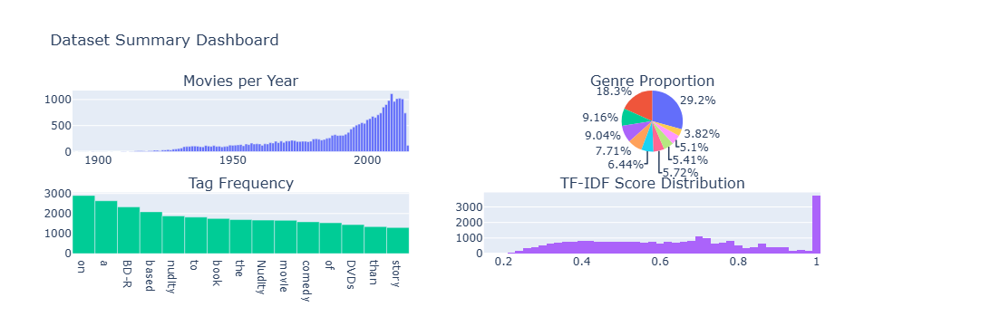

In [17]:
plot_dataset_summary()

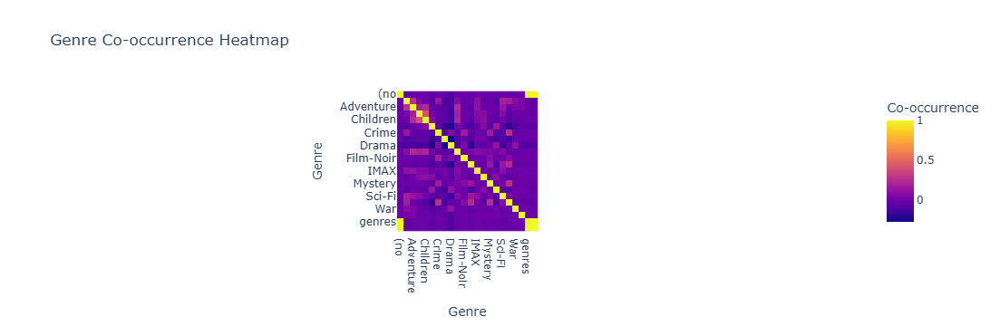

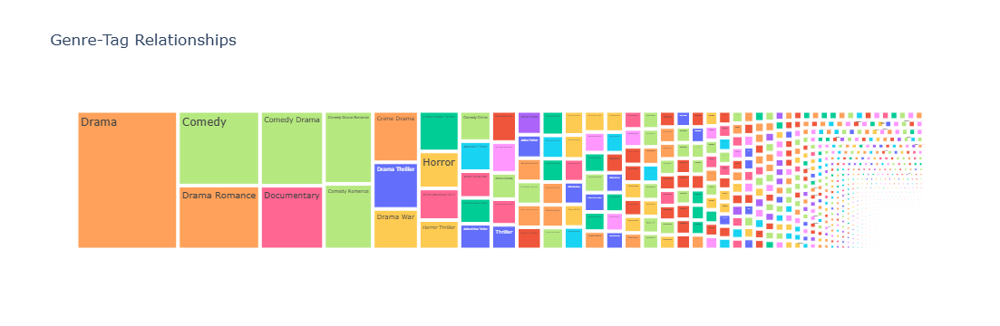

In [18]:
plot_genre_analysis()

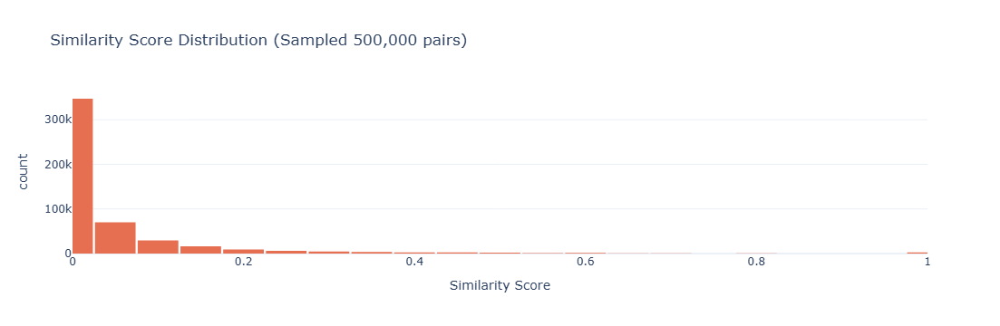

In [19]:
plot_similarity_distribution(sample_size=500000)


Recommendations for 'Toy Story (1995)':
3027                    Toy Story 2 (1999)
6271                   Finding Nemo (2003)
590                       Pinocchio (1940)
25463    Toy Story That Time Forgot (2014)
11026                          Cars (2006)
4790                 Monsters, Inc. (2001)
2270                  Bug's Life, A (1998)
15401                   Toy Story 3 (2010)
10565                Chicken Little (2005)
11614                   Ratatouille (2007)
Name: title, dtype: object


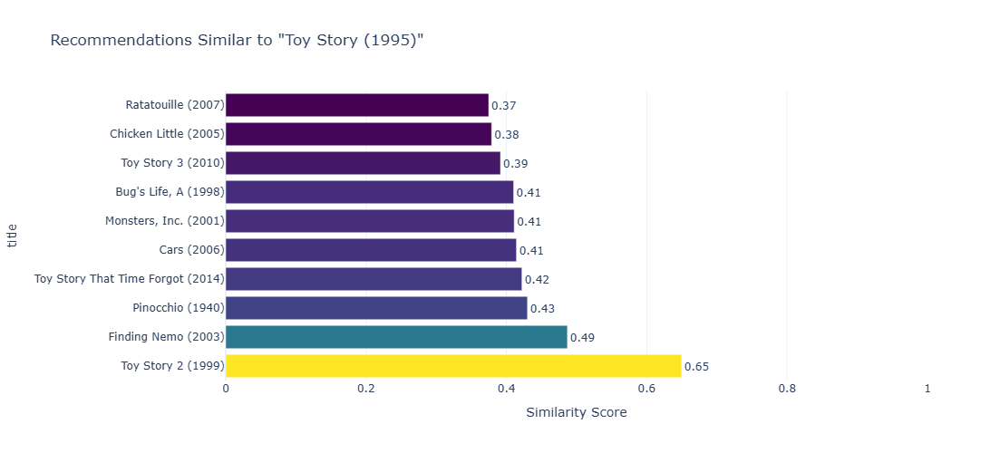

3027                    Toy Story 2 (1999)
6271                   Finding Nemo (2003)
590                       Pinocchio (1940)
25463    Toy Story That Time Forgot (2014)
11026                          Cars (2006)
4790                 Monsters, Inc. (2001)
2270                  Bug's Life, A (1998)
15401                   Toy Story 3 (2010)
10565                Chicken Little (2005)
11614                   Ratatouille (2007)
Name: title, dtype: object

In [20]:
print("\nRecommendations for 'Toy Story (1995)':")
print(get_recommendations('Toy Story (1995)'))
get_recommendations_with_plot('Toy Story (1995)')

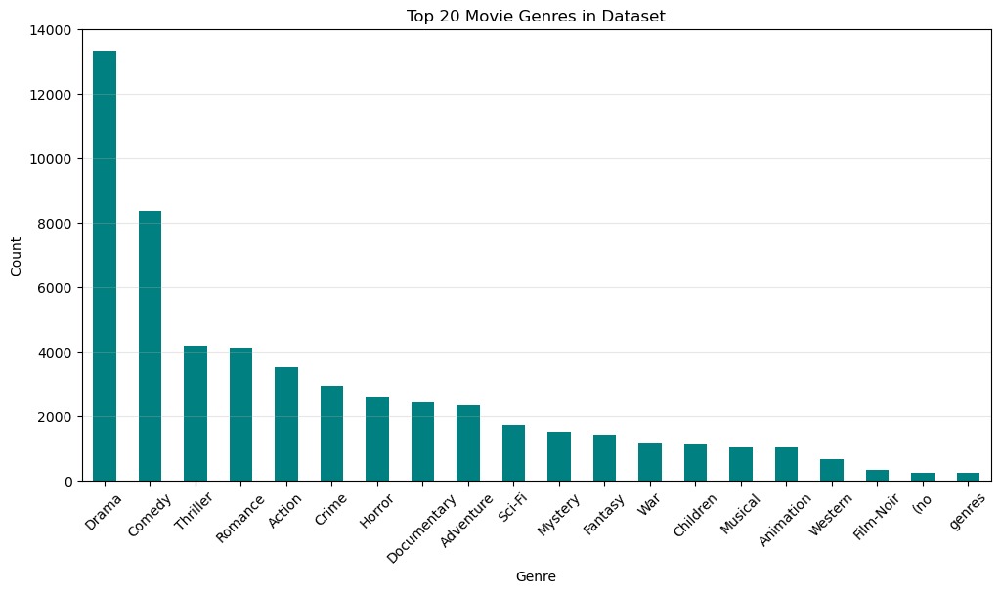

In [21]:
plt.figure(figsize=(12,6))
genre_counts = movies_df['genres'].str.split().explode().value_counts()
genre_counts[:20].plot(kind='bar', color='teal')
plt.title('Top 20 Movie Genres in Dataset')
plt.xlabel('Genre')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.grid(axis='y', alpha=0.3)
plt.show()